In [1]:
import numpy as np 
import pandas as pd 
import seaborn as sns
#import networkx as nx
import glob
import json
import matplotlib.pyplot as plt
import re
import gc

In [2]:
meta_df = pd.read_csv('./metadata.csv',usecols=["cord_uid", "sha", "title","abstract","publish_time","authors","journal","pdf_json_files","doi"])
meta_df.dropna(subset = ['abstract'],axis = 0, inplace = True)
meta_df.drop_duplicates(subset=['sha','title','abstract'],keep ='last',inplace=True)
meta_df.head()

/home/wenq/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (1,4,15) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,cord_uid,sha,title,doi,abstract,publish_time,authors,journal,pdf_json_files
0,ug7v899j,d1aafb70c066a2068b02786f8929fd9c900897fb,Clinical features of culture-proven Mycoplasma...,10.1186/1471-2334-1-6,OBJECTIVE: This retrospective chart review des...,2001-07-04,"Madani, Tariq A; Al-Ghamdi, Aisha A",BMC Infect Dis,document_parses/pdf_json/d1aafb70c066a2068b027...
1,02tnwd4m,6b0567729c2143a66d737eb0a2f63f2dce2e5a7d,Nitric oxide: a pro-inflammatory mediator in l...,10.1186/rr14,Inflammatory diseases of the respiratory tract...,2000-08-15,"Vliet, Albert van der; Eiserich, Jason P; Cros...",Respir Res,document_parses/pdf_json/6b0567729c2143a66d737...
2,ejv2xln0,06ced00a5fc04215949aa72528f2eeaae1d58927,Surfactant protein-D and pulmonary host defense,10.1186/rr19,Surfactant protein-D (SP-D) participates in th...,2000-08-25,"Crouch, Erika C",Respir Res,document_parses/pdf_json/06ced00a5fc04215949aa...
3,2b73a28n,348055649b6b8cf2b9a376498df9bf41f7123605,Role of endothelin-1 in lung disease,10.1186/rr44,Endothelin-1 (ET-1) is a 21 amino acid peptide...,2001-02-22,"Fagan, Karen A; McMurtry, Ivan F; Rodman, David M",Respir Res,document_parses/pdf_json/348055649b6b8cf2b9a37...
4,9785vg6d,5f48792a5fa08bed9f56016f4981ae2ca6031b32,Gene expression in epithelial cells in respons...,10.1186/rr61,Respiratory syncytial virus (RSV) and pneumoni...,2001-05-11,"Domachowske, Joseph B; Bonville, Cynthia A; Ro...",Respir Res,document_parses/pdf_json/5f48792a5fa08bed9f560...


In [5]:
meta_df["abstract"][1]

'Inflammatory diseases of the respiratory tract are commonly associated with elevated production of nitric oxide (NO•) and increased indices of NO• -dependent oxidative stress. Although NO• is known to have anti-microbial, anti-inflammatory and anti-oxidant properties, various lines of evidence support the contribution of NO• to lung injury in several disease models. On the basis of biochemical evidence, it is often presumed that such NO• -dependent oxidations are due to the formation of the oxidant peroxynitrite, although alternative mechanisms involving the phagocyte-derived heme proteins myeloperoxidase and eosinophil peroxidase might be operative during conditions of inflammation. Because of the overwhelming literature on NO• generation and activities in the respiratory tract, it would be beyond the scope of this commentary to review this area comprehensively. Instead, it focuses on recent evidence and concepts of the presumed contribution of NO• to inflammatory diseases of the lun

In [3]:
print(meta_df.shape)
meta_df.isnull().sum()

(345536, 9)


cord_uid               0
sha               205760
title                 43
doi               136031
abstract               0
publish_time         202
authors             2913
journal            27369
pdf_json_files    205760
dtype: int64

In [4]:
meta_df = meta_df.sample(10000, random_state=42)

A large number of documents do not have parsed full article available; we will stick to abstract first. Luckily, no abstract is missing.

In [5]:
from tqdm import tqdm
from langdetect import detect
from langdetect import DetectorFactory
DetectorFactory.seed = 77
languages = []
for i in tqdm(range(0,len(meta_df))):
    text = meta_df.iloc[i]['abstract'].split(" ")
    lang = "en"
    try:
        if len(text) > 50:
            lang = detect(" ".join(text[:50]))
        elif len(text) > 0:
            lang = detect(" ".join(text[:len(text)]))
    except Exception as e:
        lang = "unknown"
    languages.append(lang)


100%|██████████| 10000/10000 [00:38<00:00, 259.09it/s]


In [6]:
languages_dict = {}
for lang in set(languages):
    languages_dict[lang] = languages.count(lang)
print(languages_dict)

{'en': 9834, 'ro': 2, 'de': 28, 'hu': 1, 'tr': 2, 'zh-cn': 8, 'es': 41, 'unknown': 1, 'nl': 8, 'ko': 3, 'hr': 1, 'it': 3, 'pt': 42, 'fr': 26}


In [7]:
lang_df = pd.DataFrame(languages, columns=['lang'])
lang_df['is_en'] = np.where(lang_df['lang'] == 'en', 'en', 'other')
lang_df['count'] = lang_df.groupby('is_en')['is_en'].transform('count')

In [11]:
lang_df

,lang,is_en,count
0,en,en,9834
1,en,en,9834
2,en,en,9834
3,en,en,9834
4,en,en,9834
...,...,...,...
9995,en,en,9834
9996,pt,other,166
9997,en,en,9834
9998,en,en,9834


<BarContainer object of 2 artists>

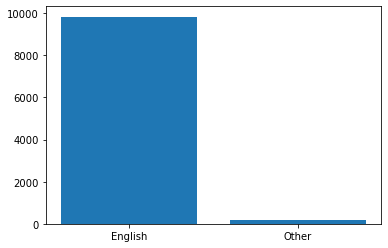

In [8]:
# sns.set_style("white")
# ax = sns.barplot(x="is_en",y = "count",data = lang_df, palette = "Set2")
# sns.despine()
# ax.get_figure().savefig("lang.png")
x = ['English', 'Other']
height = [lang_df['count'][0], 10000-lang_df['count'][0]]
plt.bar(x=x,height = height)
# , title = "English versus Non-English abstarcts distribution"

In [10]:
plt.savefig('lang.png')

<Figure size 432x288 with 0 Axes>

We will remove doucments with languages other than English

In [9]:
meta_df['language'] = languages
meta_df = meta_df[meta_df['language'] == 'en'] 
meta_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9834 entries, 427575 to 395962
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   cord_uid        9834 non-null   object
 1   sha             4046 non-null   object
 2   title           9833 non-null   object
 3   doi             6066 non-null   object
 4   abstract        9834 non-null   object
 5   publish_time    9828 non-null   object
 6   authors         9736 non-null   object
 7   journal         9110 non-null   object
 8   pdf_json_files  4046 non-null   object
 9   language        9834 non-null   object
dtypes: object(10)
memory usage: 845.1+ KB


In [10]:
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
stop = stopwords.words('english')
meta_df['abstract_no_sw'] = meta_df['abstract'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop)]))
meta_df['tokenized_abstarct'] = meta_df['abstract_no_sw'].apply(word_tokenize)

[nltk_data] Downloading package stopwords to /home/wenq/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /home/wenq/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [16]:
meta_df

,cord_uid,sha,title,doi,abstract,publish_time,authors,journal,pdf_json_files,language,abstract_no_sw,tokenized_abstarct
427575,k8hvfxr8,928b40fdbbba792e2007dd912b8e83fdc75f5382,Homo sapiens: The Superspreader of Plant Viral...,10.3390/v12121462,Plant viruses are commonly vectored by flying ...,2020-12-17,"Ranawaka, Buddhini; Hayashi, Satomi; Waterhous...",Viruses,document_parses/pdf_json/928b40fdbbba792e2007d...,en,Plant viruses commonly vectored flying crawlin...,"[Plant, viruses, commonly, vectored, flying, c..."
359165,qa6t5b0a,e7ecb4885532ab6d8f76b3fe5073545e5d8b584d,Russian Enterprises in the Spring 2020: Covid-...,10.1134/s1075700721010093,The paper analyzes and comments on the results...,2021-02-19,"Kuvalin, D. B.; Zinchenko, Yu. V.; Lavrinenko,...",Stud Russ Econ Dev,document_parses/pdf_json/e7ecb4885532ab6d8f76b...,en,The paper analyzes comments results regular su...,"[The, paper, analyzes, comments, results, regu..."
129191,pamw3fp4,NaN,Symmetry protected topological phases beyond g...,10.1103/physrevb.102.081120,We argue that the $q$-deformed spin-1 AKLT Ham...,2020-05-18,"Quella, Thomas",NaN,NaN,en,We argue $q$-deformed spin-1 AKLT Hamiltonian ...,"[We, argue, $, q, $, -deformed, spin-1, AKLT, ..."
344836,7tv4h07c,NaN,Drive-thru anticoagulation clinic: Can we supe...,NaN,Warfarin therapy requires maintenance of a the...,2020,"Truong, Lynn; Whitfield, Kevin; Nickerson-Troy...",NaN,NaN,en,Warfarin therapy requires maintenance therapeu...,"[Warfarin, therapy, requires, maintenance, the..."
165889,kax061kj,NaN,Blood pressure control and complex health cond...,NaN,The American College of Cardiology and the Ame...,2020,"Anker, Daniela; Santos-Eggimann, Brigitte; Zwa...",J. hum. hypertens,NaN,en,The American College Cardiology American Heart...,"[The, American, College, Cardiology, American,..."
...,...,...,...,...,...,...,...,...,...,...,...,...
422400,d7usd034,29da5f5d00af5c47f9b3a0a49d561f8caffb0cf3,Anti-rotaviral effects of Glycyrrhiza uralensi...,10.1186/1743-422x-9-310,BACKGROUND: Since rotavirus is one of the lead...,2012-12-18,"Alfajaro, Mia Madel; Kim, Hyun-Jeong; Park, Ju...",Virol J,document_parses/pdf_json/29da5f5d00af5c47f9b3a...,en,BACKGROUND: Since rotavirus one leading pathog...,"[BACKGROUND, :, Since, rotavirus, one, leading..."
416843,jgfz2ekm,e7ee9c56c551349e4d5c52e0ba1ec657980a9766,Is Posttraumatic Stress Disorder Meaningful in...,10.1002/jts.22592,In a recently published study in this journal ...,2020-10-02,"Shevlin, Mark; Hyland, Philip; Karatzias, Thanos",J Trauma Stress,document_parses/pdf_json/e7ee9c56c551349e4d5c5...,en,In recently published study journal used popul...,"[In, recently, published, study, journal, used..."
347171,e7z0a4tw,9bce8b421fc3bd7042acd0d52d7d6faca9039331,Coronavirus Disease 2019 and Herbal Therapy: P...,10.1007/s43450-021-00132-x,Coronavirus disease 2019 (COVID-19) is a virul...,2021-03-11,"Komolafe, Kayode; Komolafe, Titilope Ruth; Fat...",Rev Bras Farmacogn,document_parses/pdf_json/9bce8b421fc3bd7042acd...,en,Coronavirus disease 2019 (COVID-19) virulent v...,"[Coronavirus, disease, 2019, (, COVID-19, ), v..."
105694,c73m31e4,NaN,Assessment of body composition in pediatric ov...,10.1111/obr.13041,Accurate measurement of body composition is re...,2020-05-06,"Orsso, Camila E; Silva, Maria Ines B; Gonzalez...",Obesity reviews : an official journal of the I...,NaN,en,Accurate measurement body composition required...,"[Accurate, measurement, body, composition, req..."


In [18]:
from sklearn.feature_extraction.text import TfidfVectorizer
def vectorize(text, maxx_features):
    
    vectorizer = TfidfVectorizer(max_features=maxx_features)
    X = vectorizer.fit_transform(text)
    return X

In [11]:
from sklearn.feature_extraction.text import TfidfVectorizer
vec = TfidfVectorizer(max_features=2**12)
vec_matrix = vec.fit_transform(meta_df['abstract_no_sw'])
vec_matrix

<9834x4096 sparse matrix of type '<class 'numpy.float64'>'
	with 796796 stored elements in Compressed Sparse Row format>

In [17]:
# vec_matrix = vec_matrix.todense()  

In [12]:
# from sklearn.decomposition import TruncatedSVD
# pca = TruncatedSVD(n_components=2000)
# vec_matrix_pca = pca.fit_transform(vec_matrix)

from sklearn.decomposition import PCA
pca = PCA(n_components=0.95, random_state=89)
vec_matrix_pca= pca.fit_transform(vec_matrix.toarray())
vec_matrix_pca.shape

(9834, 2881)

In [ ]:
vec_matrix_pca

In [ ]:
from sklearn import metrics
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans

# run kmeans with many different k
distortions = []
K = range(2, 50)
for k in K:
    print(k)
    k_means = KMeans(n_clusters=k, random_state=77)
    k_means.fit(vec_matrix_pca)
    distortions.append(sum(np.min(cdist(vec_matrix_pca, k_means.cluster_centers_, 'euclidean'), axis=1)) / vec_matrix_pca.shape[0])
X_line = [K[0], K[-1]]
Y_line = [distortions[0], distortions[-1]]

In [ ]:
# Plot the elbow
plt.plot(K, distortions, 'b-')
plt.plot(X_line, Y_line, 'r')
plt.xlabel('Number of Clusters')
plt.ylabel('SSE')

plt.title('The Elbow Method')
plt.savefig("Elbow Method.png")
plt.show()

In [13]:
from sklearn.cluster import KMeans
abstract10 = KMeans(n_clusters=30, verbose = 0)
abstract10.fit(vec_matrix_pca)

KMeans(n_clusters=30)

In [14]:
meta_df['abstract10'] = abstract10.labels_

## t-SNE

In [15]:
from sklearn.manifold import TSNE
tsne = TSNE(verbose=1, perplexity=100, random_state=77)
vec_matrix_embedded = tsne.fit_transform(vec_matrix_pca)

[t-SNE] Computing 301 nearest neighbors...
[t-SNE] Indexed 9834 samples in 3.721s...
[t-SNE] Computed neighbors for 9834 samples in 455.000s...
[t-SNE] Computed conditional probabilities for sample 1000 / 9834
[t-SNE] Computed conditional probabilities for sample 2000 / 9834
[t-SNE] Computed conditional probabilities for sample 3000 / 9834
[t-SNE] Computed conditional probabilities for sample 4000 / 9834
[t-SNE] Computed conditional probabilities for sample 5000 / 9834
[t-SNE] Computed conditional probabilities for sample 6000 / 9834
[t-SNE] Computed conditional probabilities for sample 7000 / 9834
[t-SNE] Computed conditional probabilities for sample 8000 / 9834
[t-SNE] Computed conditional probabilities for sample 9000 / 9834
[t-SNE] Computed conditional probabilities for sample 9834 / 9834
[t-SNE] Mean sigma: 0.385386
[t-SNE] KL divergence after 250 iterations with early exaggeration: 118.921448
[t-SNE] KL divergence after 1000 iterations: 3.410550


/home/wenq/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


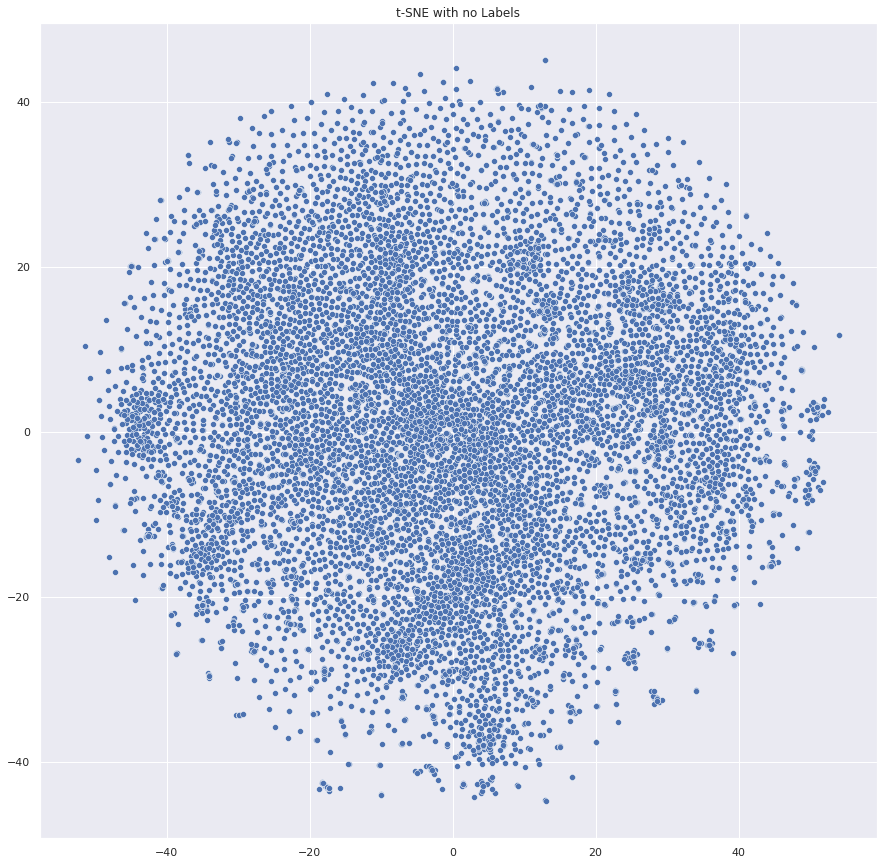

In [16]:
import seaborn as sns

sns.set(rc={'figure.figsize':(15,15)})

palette = sns.color_palette("bright", 1)


sns.scatterplot(vec_matrix_embedded[:,0], vec_matrix_embedded[:,1], palette=palette)
plt.title('t-SNE with no Labels')
plt.savefig("t-sne_covid19.png")
plt.show()

/home/wenq/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


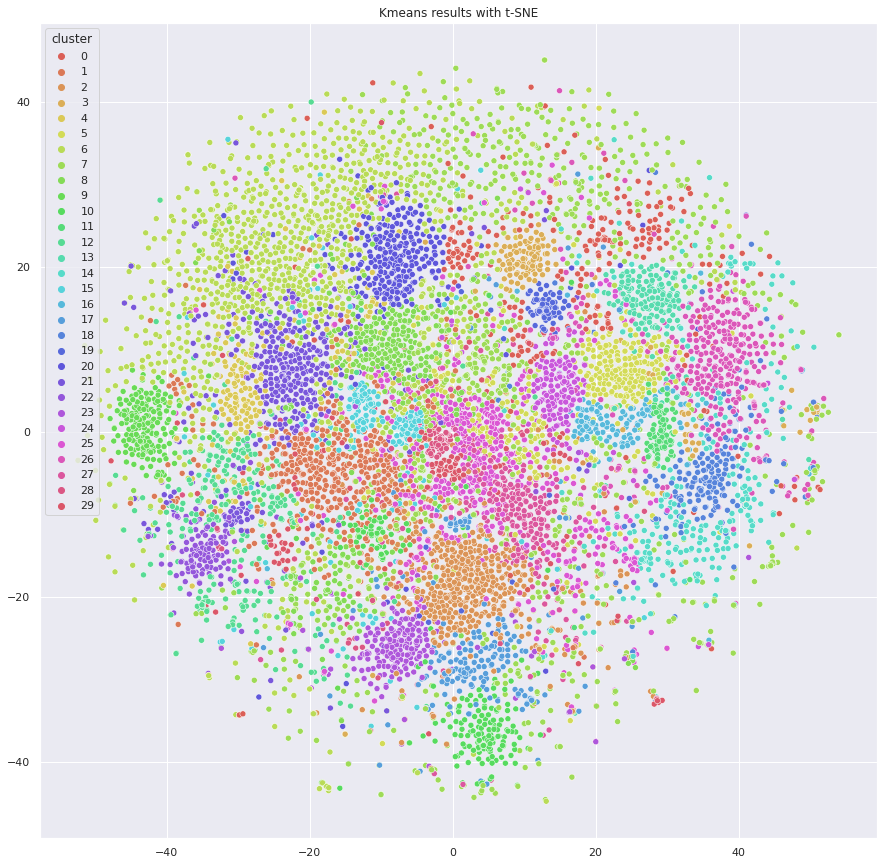

In [25]:
# sns settings
sns.set(rc={'figure.figsize':(15,15)})

# colors
palette = sns.hls_palette(30)

# plot
sns.scatterplot(vec_matrix_embedded[:,0], vec_matrix_embedded[:,1], hue=meta_df['abstract10'], legend='full', palette=palette)
plt.title('Kmeans results with t-SNE')
plt.legend(title = "cluster")
plt.savefig("tsne.png")
plt.show()

In [26]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer


In [25]:
vectorizers = []
    
for ii in range(0, 30):
    # Creating a vectorizer
    vectorizers.append(CountVectorizer(min_df=5, max_df=0.9, stop_words='english', lowercase=True, token_pattern='[a-zA-Z\-][a-zA-Z\-]{2,}'))

In [26]:
vectorized_data = []

for current_cluster, cvec in enumerate(vectorizers):
    try:
        vectorized_data.append(cvec.fit_transform(meta_df.loc[meta_df['abstract10'] == current_cluster, 'abstract_no_sw']))
    except Exception as e:
        print("Not enough instances in cluster: " + str(current_cluster))
        vectorized_data.append(None)

In [44]:
NUM_TOPICS_PER_CLUSTER = 30

lda_models = []
for ii in range(0, 30):
    # Latent Dirichlet Allocation Model
    lda = LatentDirichletAllocation(n_components=NUM_TOPICS_PER_CLUSTER, max_iter=10, learning_method='online',verbose=False, random_state=42)
    lda_models.append(lda)
    
lda_models[0]

LatentDirichletAllocation(learning_method='online', n_components=30,
                          random_state=42, verbose=False)

In [31]:
clusters_lda_data = []

for current_cluster, lda in enumerate(lda_models):
    # print("Current Cluster: " + str(current_cluster))
    
    if vectorized_data[current_cluster] != None:
        clusters_lda_data.append((lda.fit_transform(vectorized_data[current_cluster])))

NameError: name 'lda_models' is not defined

In [46]:
# Functions for printing keywords for each topic
def selected_topics(model, vectorizer, top_n=3):
    current_words = []
    keywords = []
    
    for idx, topic in enumerate(model.components_):
        words = [(vectorizer.get_feature_names()[i], topic[i]) for i in topic.argsort()[:-top_n - 1:-1]]
        for word in words:
            if word[0] not in current_words:
                keywords.append(word)
                current_words.append(word[0])
                
    keywords.sort(key = lambda x: x[1])  
    keywords.reverse()
    return_values = []
    for ii in keywords:
        return_values.append(ii[0])
    return return_values

In [47]:
all_keywords = []
for current_vectorizer, lda in enumerate(lda_models):
    # print("Current Cluster: " + str(current_vectorizer))

    if vectorized_data[current_vectorizer] != None:
        all_keywords.append(selected_topics(lda, vectorizers[current_vectorizer]))

In [48]:
all_keywords[0][:10]

['occlusion',
 'aneurysms',
 'thrombectomy',
 'stroke',
 'days',
 'ischemic',
 'embolization',
 'group',
 'treatment',
 'imaging']

In [49]:
f=open('topics.txt','w')

count = 0

for ii in all_keywords:

    if vectorized_data[count] != None:
        f.write(', '.join(ii) + "\n")
    else:
        f.write("Not enough instances to be determined. \n")
        f.write(', '.join(ii) + "\n")
    count += 1

f.close()

In [17]:
import os

topic_path = 'topics.txt'
with open(topic_path) as f:
    topics = f.readlines()

In [18]:
# required libraries for plot
import call_backs
from call_backs import input_callback, selected_code  # file with customJS callbacks for bokeh
                                                      # github.com/MaksimEkin/COVID19-Literature-Clustering/blob/master/lib/call_backs.py
import bokeh
from bokeh.models import ColumnDataSource, HoverTool, LinearColorMapper, CustomJS, Slider, TapTool, TextInput
from bokeh.palettes import Turbo256
from bokeh.transform import linear_cmap, transform
from bokeh.io import output_file, show, output_notebook
from bokeh.plotting import figure
from bokeh.models import RadioButtonGroup, TextInput, Div, Paragraph
from bokeh.layouts import column, widgetbox, row, layout
from bokeh.layouts import column


In [43]:
from call_backs import input_callback, selected_code

In [29]:
print(bokeh.__file__)

/home/wenq/anaconda3/lib/python3.8/site-packages/bokeh/__init__.py


In [69]:
from importlib import reload

reload(call_backs)
from call_backs import input_callback, selected_code

In [19]:
output_notebook()


# data sources
source = ColumnDataSource(data=dict(
    x= vec_matrix_embedded[:,0], 
    y= vec_matrix_embedded[:,1],
    x_backup = vec_matrix_embedded[:,0],
    y_backup = vec_matrix_embedded[:,1],
    desc= meta_df['abstract10'], 
    titles= meta_df['title'],
    authors = meta_df['authors'],
    journal = meta_df['journal'],
     abstract = meta_df['abstract'],
    labels = ["C-" + str(x) for x in meta_df['abstract10']],
     links = meta_df['doi']
    ))

# hover over information
hover = HoverTool(tooltips=[
    ("Title", "@titles{safe}"),
    ("Author(s)", "@authors{safe}"),
    ("Journal", "@journal"),
    ("Abstract", "@abstract{safe}"),
     ("Link", "@links")
],
point_policy="follow_mouse")

# map colors
mapper = linear_cmap(field_name='desc', 
                     palette=Turbo256,
                     low=min(meta_df['abstract10']) ,high=max(meta_df['abstract10']))

# prepare the figure
plot = figure(plot_width=1200, plot_height=850, 
           tools=[hover, 'pan', 'wheel_zoom', 'box_zoom', 'reset', 'save', 'tap'], 
           title="Clustering of the COVID-19 Literature with t-SNE and K-Means", 
           toolbar_location="above")

# plot settings
plot.scatter('x', 'y', size=5, 
          source=source,
          fill_color=mapper,
          line_alpha=0.3,
          line_color="black",
          legend = 'labels')
plot.legend.background_fill_alpha = 0.6

Loading BokehJS ...

In [20]:
text_banner = Paragraph(text= 'Keywords: Slide to specific cluster to see the keywords.', height=25)
input_callback_1 = input_callback(plot, source, text_banner, topics)

# currently selected article
div_curr = Div(text="""Click on a plot to see the link to the article.""",height=150)
callback_selected = CustomJS(args=dict(source=source, current_selection=div_curr), code=selected_code())
taptool = plot.select(type=TapTool)
taptool.callback = callback_selected

# WIDGETS
slider = Slider(start=0, end=30, value=30, step=1, title="Cluster #", callback=input_callback_1)
keyword = TextInput(title="Search:", callback=input_callback_1)

# pass call back arguments
input_callback_1.args["text"] = keyword
input_callback_1.args["slider"] = slider
# column(,,widgetbox(keyword),,widgetbox(slider),, notes, cite, cite2, cite3), plot

In [21]:
# STYLE
slider.sizing_mode = "stretch_width"
slider.margin=15

keyword.sizing_mode = "scale_both"
keyword.margin=15

div_curr.style={'color': '#BF0A30', 'font-family': 'Helvetica Neue, Helvetica, Arial, sans-serif;', 'font-size': '1.1em'}
div_curr.sizing_mode = "scale_both"
div_curr.margin = 20

text_banner.style={'color': '#0269A4', 'font-family': 'Helvetica Neue, Helvetica, Arial, sans-serif;', 'font-size': '1.1em'}
text_banner.sizing_mode = "scale_both"
text_banner.margin = 20

plot.sizing_mode = "scale_both"
plot.margin = 5

r = row(div_curr,text_banner)
r.sizing_mode = "stretch_width"


In [22]:
# LAYOUT OF THE PAGE
l = layout([
    [slider, keyword],
    [text_banner],
    [div_curr],
    [plot],
])
l.sizing_mode = "scale_both"

# show
output_file('t-sne_covid-19_interactive.html')
show(l)

In [80]:
show(column(plot))